In [1]:
import tensorflow as tf
import numpy as np
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import os
from glob import glob
from models import IRUNet
import loss_functions as lf

2024-09-09 16:27:37.738555: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0


In [2]:
def load_model(model, folder, shape, loss=lf.mae_ssim_ms_loss(max_val_ssim=1., alpha=0.7)):
    model.compile(loss=loss, optimizer=tf.keras.optimizers.Adam(), metrics=['mae'])
    model.build(input_shape=(None,shape[0],shape[1],shape[2]))

    # Load the model weights if model is given
    chk_fn = [os.path.join(folder, file) for file in os.listdir(folder) if file.endswith(".hdf5")][0]
    model.load_weights(chk_fn)

    # Check if a training .log file are present
    base_folder, _ = os.path.split(chk_fn)
    try:
        log_file = [os.path.join(base_folder, file) for file in os.listdir(base_folder) if file.endswith(".csv")][0]
    except:
        log_file = [os.path.join(base_folder, file) for file in os.listdir(base_folder) if file.endswith(".log")][0]

    return model, log_file

input_shape = (256, 256, 1)
model = IRUNet(input_shape=input_shape)
model, _ = load_model(model, "./", input_shape)

2024-09-09 16:27:39.104730: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2024-09-09 16:27:39.105776: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2024-09-09 16:27:39.132134: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:75:01.0 name: NVIDIA L20 computeCapability: 8.9
coreClock: 2.52GHz coreCount: 92 deviceMemorySize: 47.50GiB deviceMemoryBandwidth: 804.75GiB/s
2024-09-09 16:27:39.132155: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2024-09-09 16:27:39.157149: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.11
2024-09-09 16:27:39.157216: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublasLt.so.11
2024-09-09 

In [3]:
def visual(lc, hc, out, f):
    n_lc = (((lc - lc.min()) / (lc.max() - lc.min())) * 255).astype(np.uint8)
    n_hc = (((hc - hc.min()) / (hc.max() - hc.min())) * 255).astype(np.uint8)
    n_out = (((out - out.min()) / (out.max() - out.min())) * 255).astype(np.uint8)
    
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))  # 1 row, 3 columns, figsize adjusted to 15x5
    plt.subplots_adjust(wspace=0.3, hspace=0.3)  # Adjust the spacing between the subplots
    
    axs[0].imshow(n_lc, cmap='gray')
    axs[0].set_title('LC')
    axs[0].axis('off')  # Turn off axis numbers and ticks

    axs[1].imshow(n_hc, cmap='gray')
    axs[1].set_title('HC')
    axs[1].axis('off')  # Turn off axis numbers and ticks

    axs[2].imshow(n_out, cmap='gray')
    axs[2].set_title('Output')
    axs[2].axis('off')  # Turn off axis numbers and ticks

    fig.suptitle(f, fontsize=16) 
    
    plt.show()

In [4]:
def process_image(image_path):
    # 函数用于载入和预处理图片

    def __get_normalized_image(img):
        # 根据提供的scale范围归一化图像
        scale = 6666
        img = np.clip(img, a_min=0., a_max=None)
        sum_img = np.sum(img)
        img = img / np.sum(img) * scale
        return np.clip(img, a_min=0., a_max=1.)
    
    # 首先载入图片
    img = Image.open(image_path)

    # 转换图片为numpy数组
    img_array = np.asarray(img, dtype=np.float32)

    # 归一化图像
    img_normalized = __get_normalized_image(img_array)
    
    # 返回处理后的图片
    return img_normalized

def is_image_file(filename):
    return any(filename.endswith(extension) for extension in ['jpeg', 'JPEG', 'jpg', 'png', 'JPG', 'PNG', 'gif', 'tif'])

2024-09-09 16:27:39.687308: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:116] None of the MLIR optimization passes are enabled (registered 2)
2024-09-09 16:27:39.687763: I tensorflow/core/platform/profile_utils/cpu_utils.cc:112] CPU Frequency: 2600000000 Hz


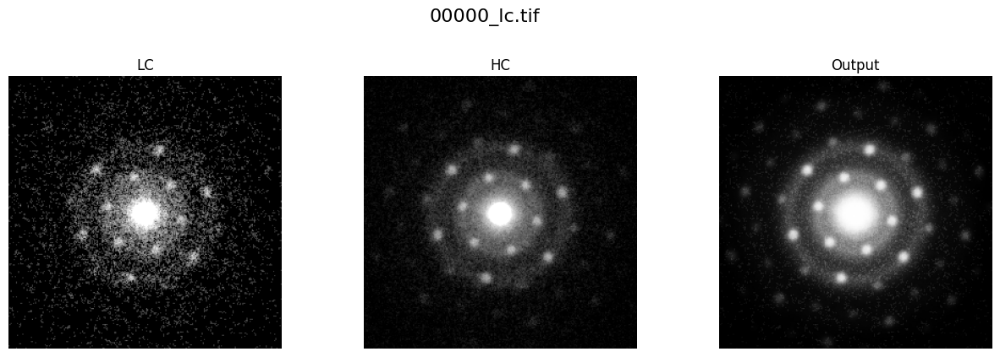

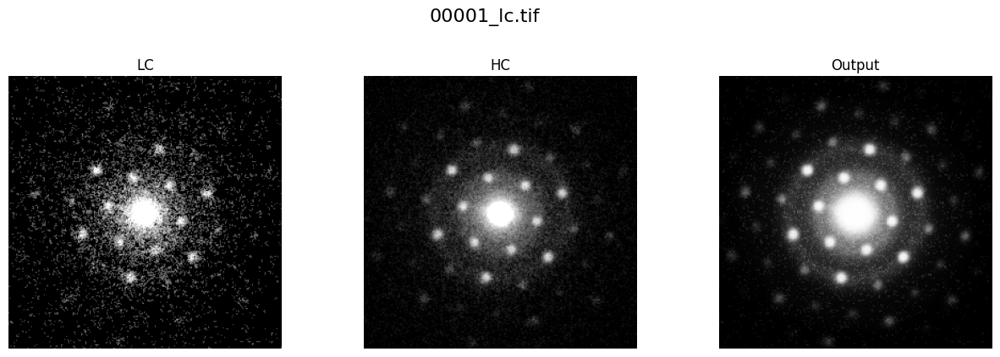

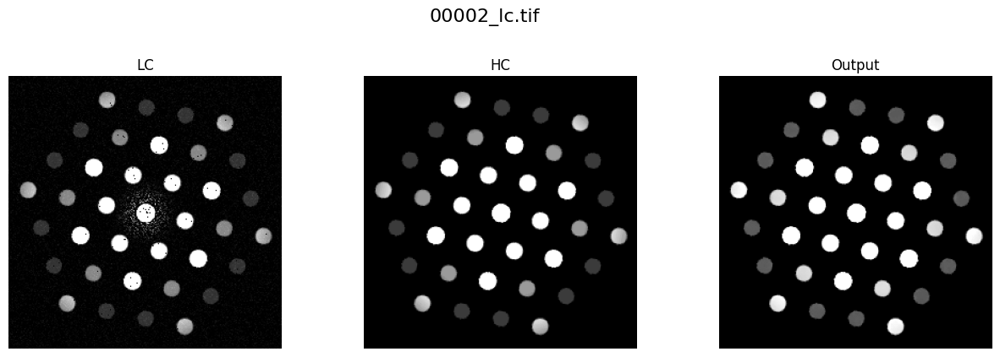

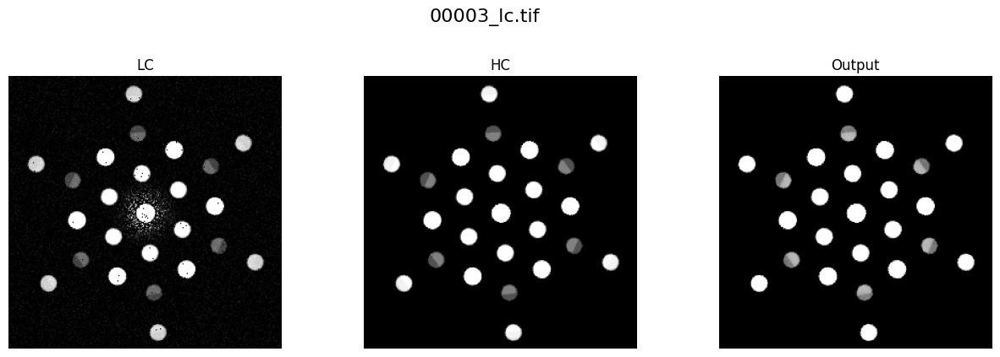

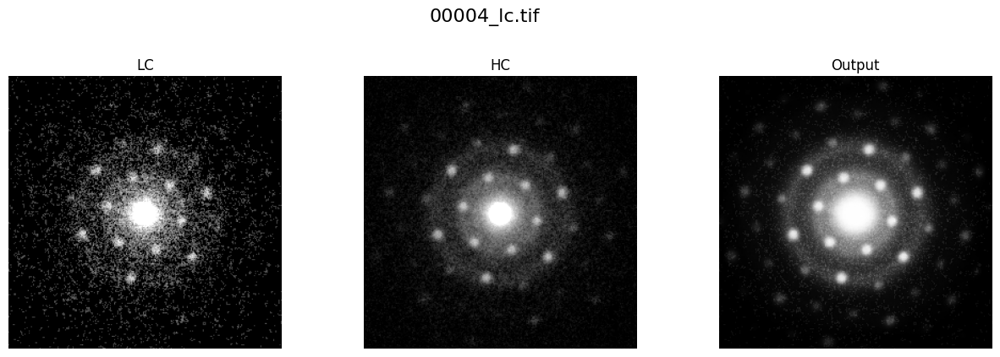

...

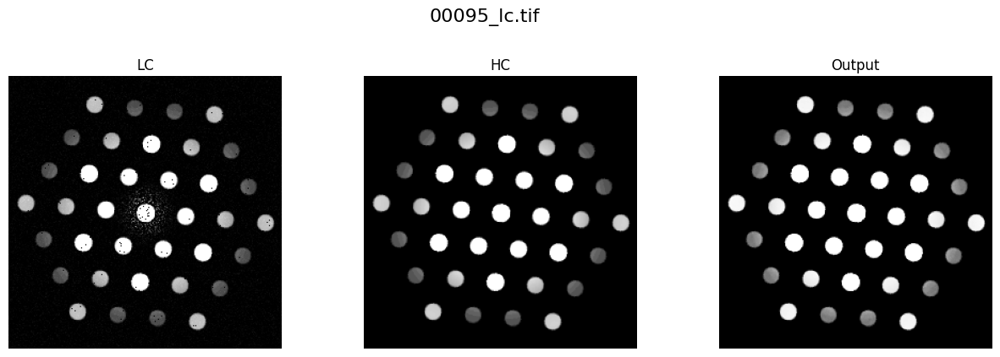

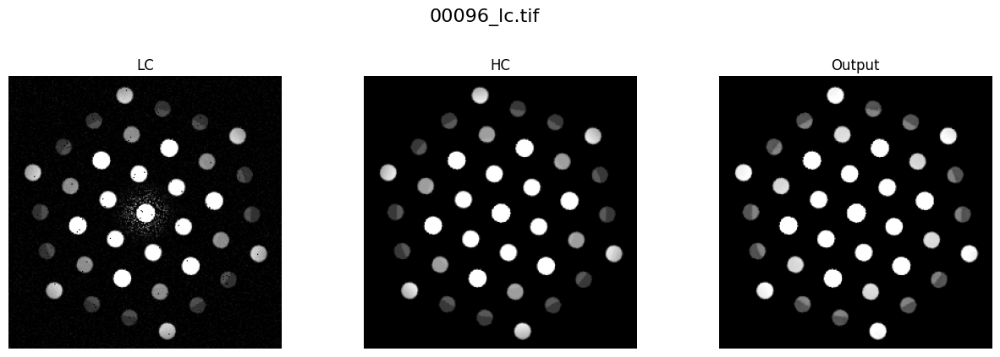

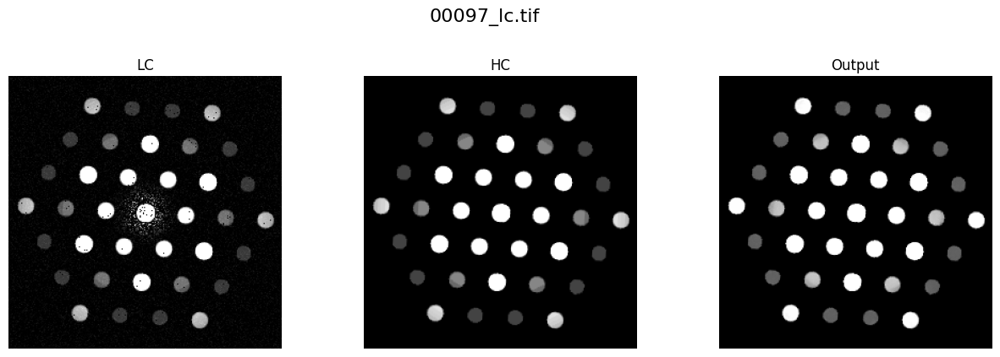

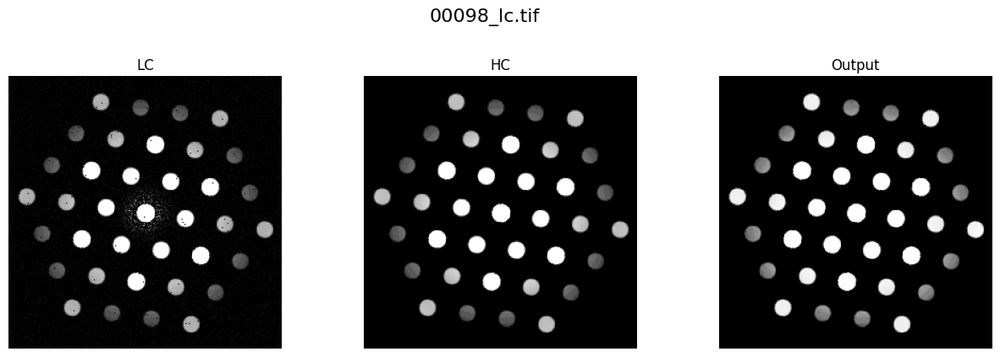

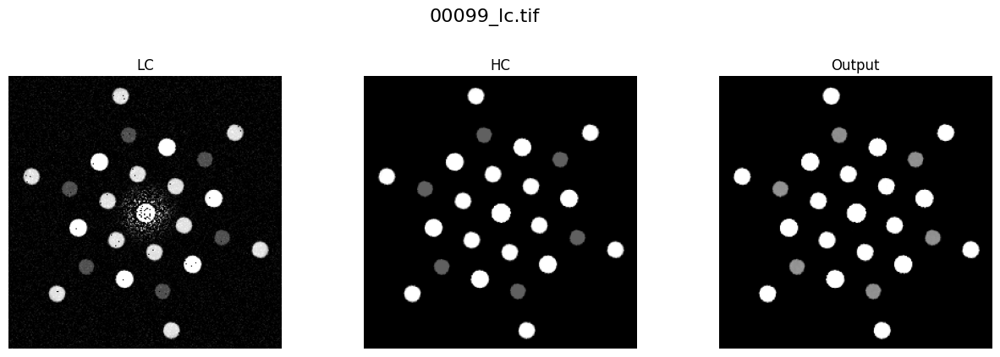

In [5]:
inp_dir = '../example_data/validation/LC/'
inp_files = sorted(os.listdir(inp_dir))
inp_filenames = [os.path.join(inp_dir, x) for x in inp_files if is_image_file(x)]
for f in inp_filenames:
    lc_img = process_image(f)
    hc_f = f.replace('LC', 'HC')
    hc_f = hc_f.replace('lc', 'hc')
    hc_img = process_image(hc_f) 
    out_img = model.predict(lc_img.reshape(1, 256, 256, 1))
    
    visual(lc_img, hc_img, out_img.reshape(256,256,1), f.replace('../example_data/validation/LC/', '' ))